In [1]:
from sklearn.svm import SVC, LinearSVC
from sklearn import datasets

import numpy as np
import matplotlib.pyplot as plt

def map_color(array):
    colors = ['red', 'green', 'blue']
    return [colors[i] for i in array]

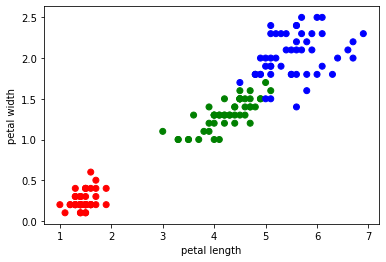

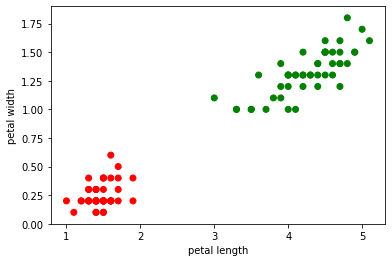

In [2]:
iris = datasets.load_iris()
X = iris["data"][:, (2, 3)]  # petal length, petal width
y = iris["target"]

def plot_data(X, y):
    X_length = X[:, 0]
    X_width = X[:, 1]
    plt.figure()
    plt.xlabel('petal length')
    plt.ylabel('petal width')
    plt.scatter(X_length, X_width, color=map_color(y))

plot_data(X, y)

setosa_or_versicolor = (y == 0) | (y == 1)
X = X[setosa_or_versicolor]
y = y[setosa_or_versicolor]
plot_data(X, y)



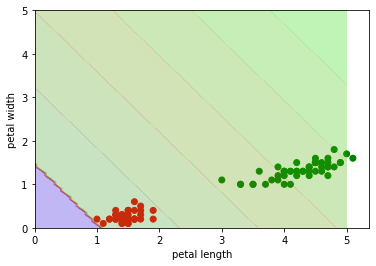

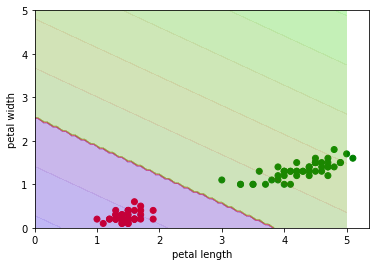

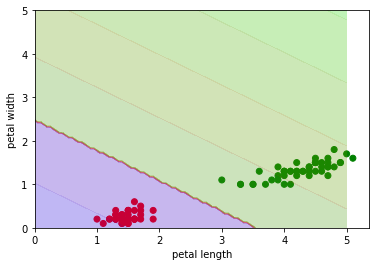

In [3]:
# Avec LinearSVC

def plot_svm(model, X, y, xmin=0, xmax=5, n_points=101, ymin=None, ymax=None):
    ymin = ymin or xmin
    ymax = ymax or xmax
    # On crée toute une grille de point à faire évaluer par le modèle
    x0_axis = np.linspace(xmin, xmax, n_points)
    x1_axis = np.linspace(ymin, ymax, n_points)
    x0_grid, x1_grid = np.meshgrid(x0_axis, x1_axis)
    
    # .ravel() va mettre la grille de taille 101 x 101 par ex, en taille 101² en l'applatissant en vecteur
    decision_X = np.c_[x0_grid.ravel(), x1_grid.ravel()] # On a alors dans une matrice X toutes les combinaisons possibles

    y_decision = model.decision_function(decision_X).reshape(x0_grid.shape)
    y_pred = model.predict(decision_X).reshape(x0_grid.shape)

    # b = model.intercept_
    # w = model.coef_
    # b + x0.w0 + x1*w1 = 0
    # x1_axis = (- b.item() - x0_axis * w[0][0]) / w[0][1]
    # plot_data(X,y)
    # plt.plot(x0_axis, x1_axis)

    plot_data(X,y)
    plt.contourf(x0_grid, x1_grid, y_decision, cmap=plt.cm.brg, alpha=0.1)
    plt.contourf(x0_grid, x1_grid, y_pred, cmap=plt.cm.brg, alpha=0.2)

for C in [0.01, 0.1, 1]:
    # On voit que quand le paramètre C des slack variables ne régularise pas assez, les slack variables peuvent être très grand, et on n'ajuste pas correctement
    linearsvc = LinearSVC(loss="hinge", C=C)
    linearsvc.fit(X, y) 
    plot_svm(linearsvc, X, y)


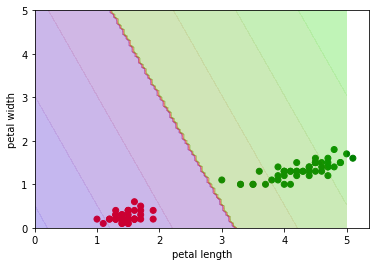

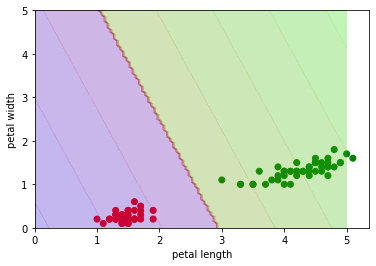

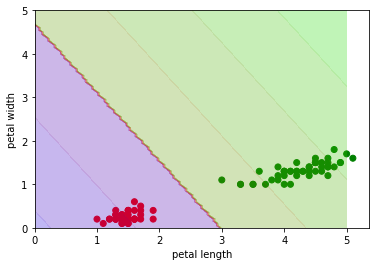

In [4]:
# Avec SVC
for C in [0.01, 0.1, 1]:
    svc = SVC(kernel='linear', C=C)
    svc.fit(X, y) 
    plot_svm(svc, X, y)

# Dans le cas Non linéairement séparable

/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':
/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':
/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':
/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':
0.6766666666666666
0.68
0.67


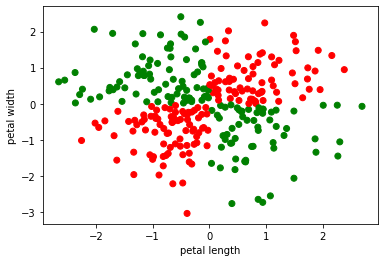

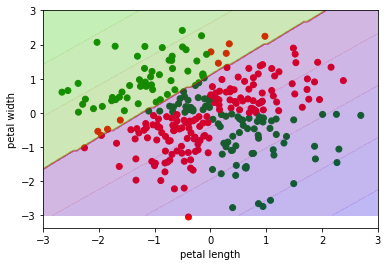

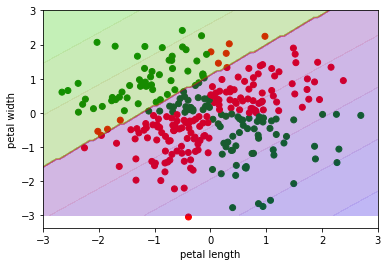

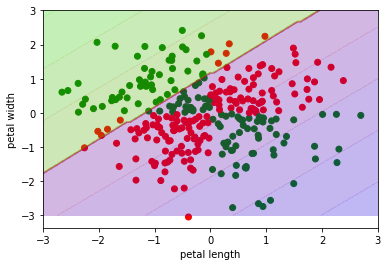

In [5]:

def generate_non_linear_data():
    xx, yy = np.meshgrid(np.linspace(-3, 3, 500),
                     np.linspace(-3, 3, 500))
    np.random.seed(0)
    X = np.random.randn(300, 2)
    Y = np.logical_xor(X[:, 0] > 0, X[:, 1] > 0)
    return X, Y

X, y = generate_non_linear_data()
plot_data(X, y)

# Let's see how a linearSVC can do on it
for C in [1, 10, 100]:
    linear1 = LinearSVC(loss="hinge", C=C)
    linear1.fit(X,y)
    plot_svm(linear1, X, y, xmin=-3, xmax=3)
    print(linear1.score(X, y))



0.5266666666666666
0.5266666666666666
/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':
/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':
0.5266666666666666
0.5266666666666666
/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':
/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':
0.5333333333333333
0.6733333333333333
/home/johnny/.local/lib/python3.6/site-packages/ipykernel_laun

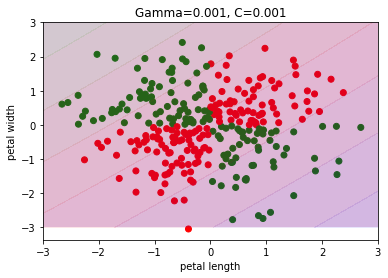

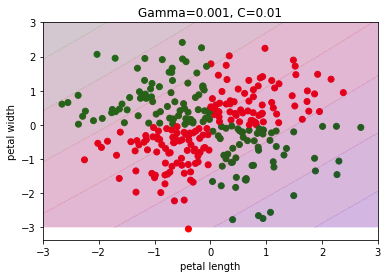

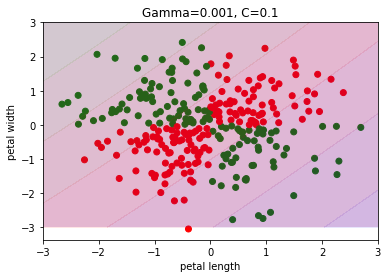

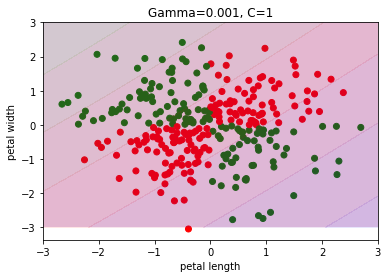

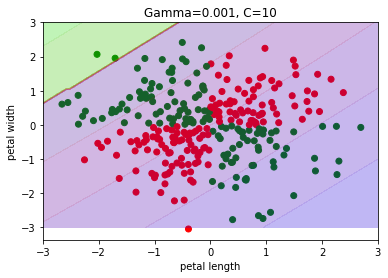

...

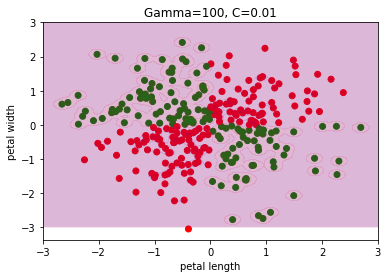

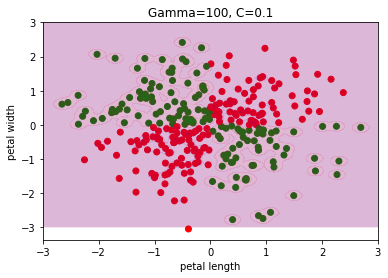

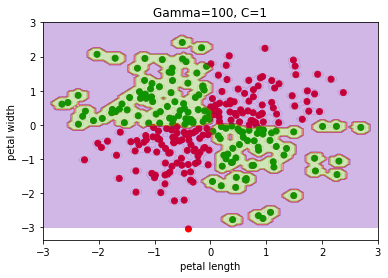

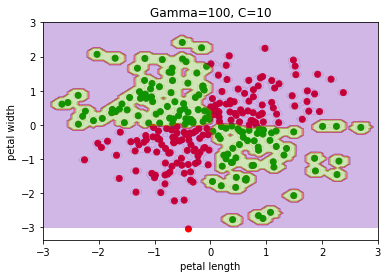

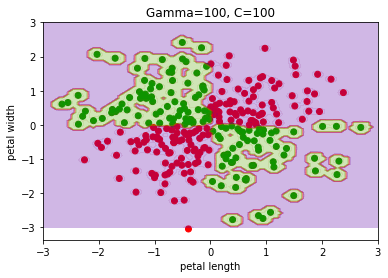

In [6]:
# What about a non linear model

def multiplot(X, y, gamma_list, C_list, xmin, xmax, ymin=None, ymax=None):
    for gamma in gamma_list:
        for C in C_list:
            gaussian = SVC(kernel="rbf", gamma=gamma, C=C)
            gaussian.fit(X,y)
            print(gaussian.score(X, y))
            plot_svm(gaussian, X, y,  xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax)
            plt.title(f"Gamma={gamma}, C={C}")

multiplot(X, y, [0.001, 0.01, 0.1, 1, 10, 100], [0.001, 0.01, 0.1, 1, 10, 100], xmin=-3, xmax=3)

In [12]:
# Let's try to find Gamma and C optimum using cross-validation
from sklearn.model_selection import cross_val_score, GridSearchCV

gamma_list = [0.1, 1, 10, 100]
C_list = [0.1, 1, 10, 100]

def custom_grid_search(X, y, gamma_list, C_list):
    scores_gamma_C = {}
    best_gamma = 0
    best_C = 0
    best_score = 0
    for gamma in gamma_list:
        for C in C_list:
            gaussian = SVC(kernel="rbf", gamma=gamma, C=C)
            scores = cross_val_score(gaussian, X, y, cv=5)
            mean_score = np.mean(scores)
            
            scores_gamma_C[(gamma, C)] = mean_score

            if mean_score > best_score:
                best_gamma = gamma
                best_C = C
                best_score = mean_score
    print(f"Best Params (Gamma, C): {(best_gamma, best_C)}")
    print(f"Best score:{best_score}")
    print(f"All mean scores: {scores_gamma_C}")


def gridsearchScikit(X, Y, gamma_list, C_list, refit=False):
    params_grid = [
        {
            "gamma": gamma_list,
            "C" : C_list
        }
    ]
    gaussian = SVC(kernel="rbf")
    search = GridSearchCV(gaussian, cv=5, param_grid=params_grid, refit=refit)
    search.fit(X, y)
    print(f"Best params : {search.best_params_}")
    print(f"Best score : {search.best_score_}")
    print(f"CV results")
    print(search.cv_results_)
    return gaussian
    

custom_grid_search(X, y, gamma_list, C_list)
print("\n")
print("GridSearch of scikit")
best_gaussian = gridsearchScikit(X, y, gamma_list, C_list, refit=True)

Best Params (Gamma, C): (1, 100)
Best score:0.9833861257756784
All mean scores: {(0.1, 0.1): 0.6166925997962396, (0.1, 1): 0.7898425488561638, (0.1, 10): 0.9366518477354822, (0.1, 100): 0.9732147818838566, (1, 0.1): 0.9233713068444939, (1, 1): 0.9463767713253682, (1, 10): 0.9766629619338705, (1, 100): 0.9833861257756784, (10, 0.1): 0.766725942391405, (10, 1): 0.9536556450865982, (10, 10): 0.9603241641196629, (10, 100): 0.9602130221357784, (100, 0.1): 0.5266722237658609, (100, 1): 0.8267407613225896, (100, 10): 0.8401889413726036, (100, 100): 0.8401889413726036}


GridSearch of scikit
Best params : {'C': 100, 'gamma': 1}
Best score : 0.9833333333333333
CV results
{'mean_fit_time': array([0.0022428 , 0.00147524, 0.00188551, 0.00201945, 0.00133314,
       0.00094609, 0.00203214, 0.00235076, 0.00111742, 0.00091147,
       0.0015161 , 0.00262871, 0.00100226, 0.00095925, 0.00150695,
       0.00236206]), 'std_fit_time': array([6.01547623e-04, 2.52050727e-05, 3.01143622e-04, 5.70946343e-05,
  

Matrice de confusion: [[150   8]
 [  9 133]]
[precision, recall, f1]: [0.9432624113475178, 0.9366197183098591, 0.9399293286219081]


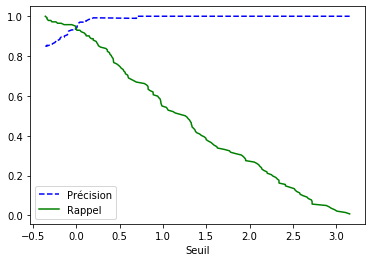

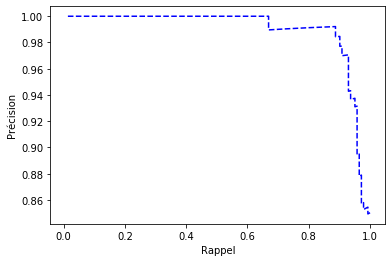

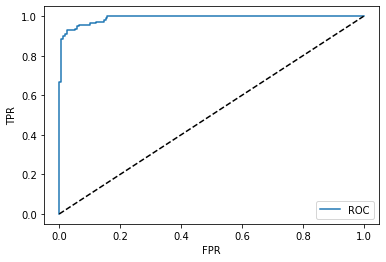

In [26]:
# Etude de la matrice de confusion, précision, rappel et ROC

from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score, precision_recall_curve, roc_curve

y_train_pred = cross_val_predict(best_gaussian, X, y, cv=5)
conf_matrix = confusion_matrix(y, y_train_pred)
precision = precision_score(y, y_train_pred)
recall = recall_score(y, y_train_pred)
f1 = f1_score(y, y_train_pred)
print(f"Matrice de confusion: {conf_matrix}")
print(f"[precision, recall, f1]: {[precision, recall, f1]}")

def plot_precision_recall_vs_threshold(X, y, model):
    y_scores = cross_val_predict(model, X, y, cv=5, method="decision_function")
    precision, recalls, thresholds = precision_recall_curve(y, y_scores)
    fpr, tpr,_ = roc_curve(y, y_scores)

    # plot Précision & Rappel / Seuil
    plt.figure()
    plt.plot(thresholds, precision[:-1], "b--", label="Précision")
    plt.plot(thresholds, recalls[:-1], "g-", label="Rappel")
    plt.legend()
    plt.xlabel("Seuil")
    plt.show()

    # plot Précision/Rappel
    plt.figure()
    plt.plot(recalls[:-1], precision[:-1], "b--")
    plt.xlabel("Rappel")
    plt.ylabel("Précision")
    plt.show()

    # courbe ROC: TPR/FPR
    plt.figure()
    plt.plot(fpr, tpr, label="ROC")
    plt.plot([0,1], [0,1], 'k--')
    plt.xlabel("FPR")
    plt.ylabel("TPR")
    plt.legend()
    plt.show()

plot_precision_recall_vs_threshold(X, y, best_gaussian)

# Qu'est-ce qui se passe si les données ne sont pas sur la même échelle

/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':
0.5266666666666666
/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':
0.5566666666666666
/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':
0.5533333333333333
/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':
0.5633333333333334
/home/johnny/.local/lib/python3.6/site-packages/ipykernel_launcher.py:9: DeprecationWarning: In futu

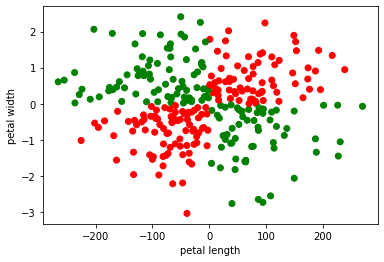

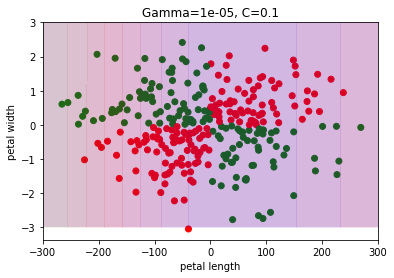

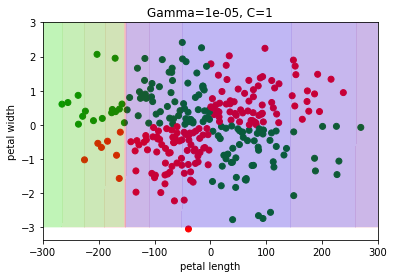

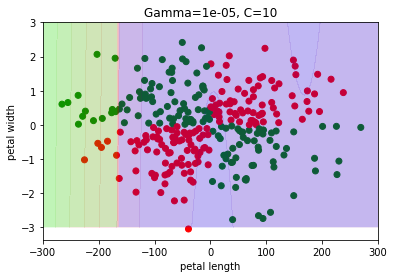

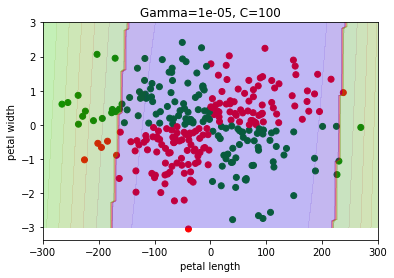

...

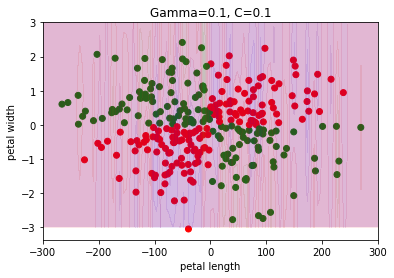

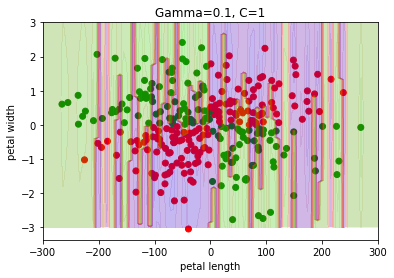

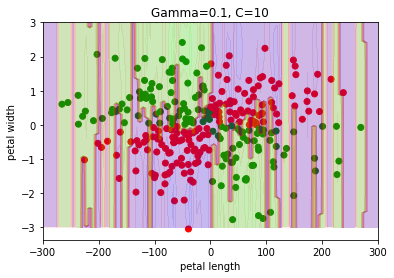

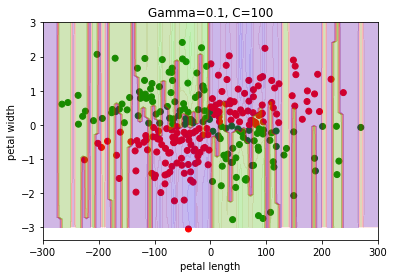

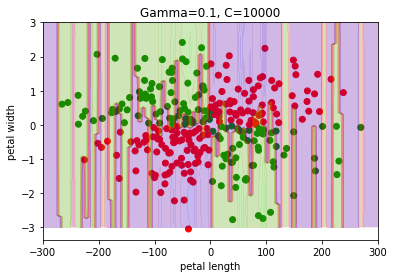

In [9]:
def scale_and_plot(X, y, scaling = 10):
    X_echelle = np.copy(X)
    X_echelle[:, 0] = scaling * X_echelle[:, 0]

    plot_data(X_echelle, y)
    
    multiplot(X_echelle, y, [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 0.1], C_list + [10000], xmin=-3*scaling, xmax=3*scaling, ymin=-3, ymax=3)
    # Plusieurs observations:
    # 1) Du fait que la variable x0 ait été scalée de 100 par ex, la distance que le kernel gaussien va calculer sera très biaisée. La distance calculée est exp(-gamma * || a - b ||²). Imaginons que a = (500, -5), et b = (550, 5)

    # la norme || a - b ||² vaudra (50²) + (10²), et sera beaucoup plus influencer par l'écart de x0 qui est grand. Cet écart est grand en absolu à cause du scaling, mais en vérité, c'était probablement des points très proches sur l'axe x0

    # De ce fait, la distance valant exp(-gamma * || a - b ||²) explose même pour des points très proche
    # Et de ce fait, le modèle va trouver des "creux" entre 2 points pourtant très proches, mais qu'il trouvera éloigné à cause du scaling.
    # Pour éviter qu'il n'explose, il faudra fortement réduire gamma pour éviter que la distance explose quand (a, b) sont en fait proche (relativement au scaling
    # D'ailleurs, les "creux" sont permis à cause de la régularité C. Comme le scaling augmente la change que le modèle trouve des creux, il faut augmenter C pour d'autant le forcer à se régulariser et éviter les creux


    # C'est pour ça qu'il est préférable de standardiser pour à peu près avoir la bonne échelle, et éviter que les hyperparamètres n'explosent
    # gridsearchScikit(X_echelle, y, gamma_list, C_list)

scale_and_plot(X, y, 100)


10